In [124]:
import os
import torch
from torchvision import io # type: ignore
from torchvision import transforms as T
import numpy as np
from tqdm import tqdm
from PIL import Image

def show_image(image):
    if image.shape[2] != 3: image = image.permute(1, 2, 0)
    image = Image.fromarray(image.numpy())
    return image

In [125]:
from semseg import show_models

show_models()

  No.  Model Names
-----  -------------
    1  SegFormer
    2  Lawin
    3  SFNet
    4  BiSeNetv1
    5  DDRNet
    6  FCHarDNet
    7  BiSeNetv2


In [4]:
from pathlib import Path
import gdown

ckpt = Path('./checkpoints/pretrained/segformer')
ckpt.mkdir(exist_ok=True, parents=True)

url = 'https://drive.google.com/uc?id=1-OmW3xRD3WAbJTzktPC-VMOF5WMsN8XT'
output = './checkpoints/pretrained/segformer/segformer.b3.ade.pth'

gdown.download(url, output, quiet=False)

Downloading...
From (original): https://drive.google.com/uc?id=1-OmW3xRD3WAbJTzktPC-VMOF5WMsN8XT
From (redirected): https://drive.google.com/uc?id=1-OmW3xRD3WAbJTzktPC-VMOF5WMsN8XT&confirm=t&uuid=5ff9de31-5a37-4197-a539-c66e6900d07c
To: /Users/izzan/walkability_index/semantic-segmentation/notebooks/checkpoints/pretrained/segformer/segformer.b3.ade.pth
100%|██████████| 190M/190M [00:14<00:00, 12.6MB/s] 


'./checkpoints/pretrained/segformer/segformer.b3.ade.pth'

In [126]:
from semseg.models import *

model = eval('SegFormer')(
    backbone='MiT-B3',
    num_classes=150
)

try:
    model.load_state_dict(torch.load('../checkpoints/pretrained/segformer/segformer.b3.ade.pth', map_location='cpu'))
except:
    print("Download a pretrained model's weights from the result table.")
model.eval()

print('Loaded Model')

Loaded Model


In [127]:
from semseg.datasets import *

palette = eval('ADE20K').PALETTE
classes = eval('ADE20K').CLASSES

In [128]:
from PIL import Image, ImageDraw, ImageFont

# Sample data: (RGB color, class name)
# legend_data = [
#     ((255, 0, 0), "Class A"),
#     ((0, 255, 0), "Class B"),
#     ((0, 0, 255), "Class C"),
#     ((255, 255, 0), "Class D"),
# ]

def create_legend_image(legend_data):

# Settings
    box_size = 30  # Size of the color box
    spacing = 10   # Space between items
    padding = 30   # Padding around the legend
    font_size = 20  # Font size

    # Try loading a default font
    try:
        font = ImageFont.truetype("arial.ttf", font_size)
    except IOError:
        font = ImageFont.load_default(font_size)

    # Calculate image size
    max_text_width = 5*font_size#max([font_size for _, name in legend_data])
    img_width = box_size + spacing + max_text_width + 2 * padding
    img_height = len(legend_data) * (box_size + spacing) + 2 * padding

    # Create a new white image
    legend_img = Image.new("RGB", (img_width, img_height), color=(255, 255, 255))
    draw = ImageDraw.Draw(legend_img)

    # Draw legend items
    y_offset = padding
    for color, name in legend_data:
        # Draw color box
        draw.rectangle(
            [padding, y_offset, padding + box_size, y_offset + box_size],
            fill=color,
            outline=color,
        )
        # Draw text
        draw.text(
            (padding + box_size + spacing, y_offset + 5),
            name,
            fill=(0,0,0),
            font=font,
        )
        y_offset += box_size + spacing  # Move to next item
    return legend_img
# Show and save the legend
# legend_img.show()
# legend_img.save("legend.png")

# explore

torch.Size([3, 964, 1280])


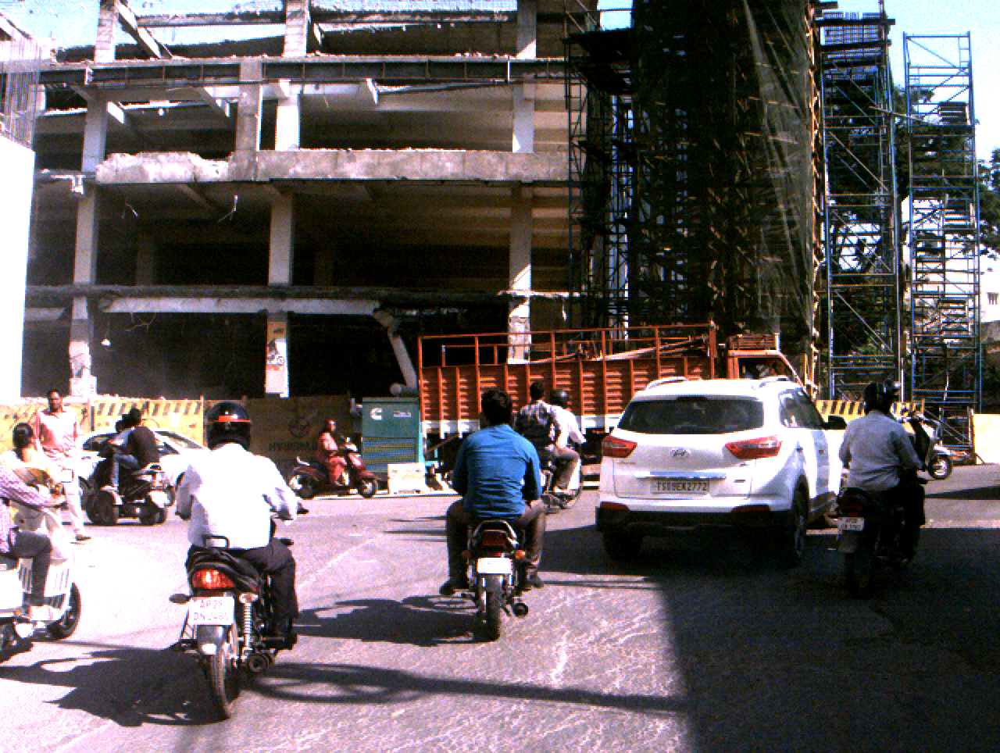

In [ ]:
image_path = '../../dataset/IDD_Segmentation/leftImg8bit/train/0/024541_leftImg8bit.png'
image = io.read_image(image_path)
print(image.shape)
show_image(image)

In [6]:
# resize
# image = T.CenterCrop((1080, 1920))(image)
# scale to [0.0, 1.0]
prep_image = image.float() / 255
# normalize
prep_image = T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))(prep_image)
# add batch size
prep_image = prep_image.unsqueeze(0)
prep_image.shape

torch.Size([1, 3, 964, 1280])

In [7]:
with torch.inference_mode():
    seg = model(prep_image)
seg.shape

torch.Size([1, 150, 964, 1280])

In [59]:
legend_data = [(tuple(color.tolist()),clas) for color, clas in zip(palette[seg.unique()].squeeze(),[classes[i] for i in seg.unique()])]

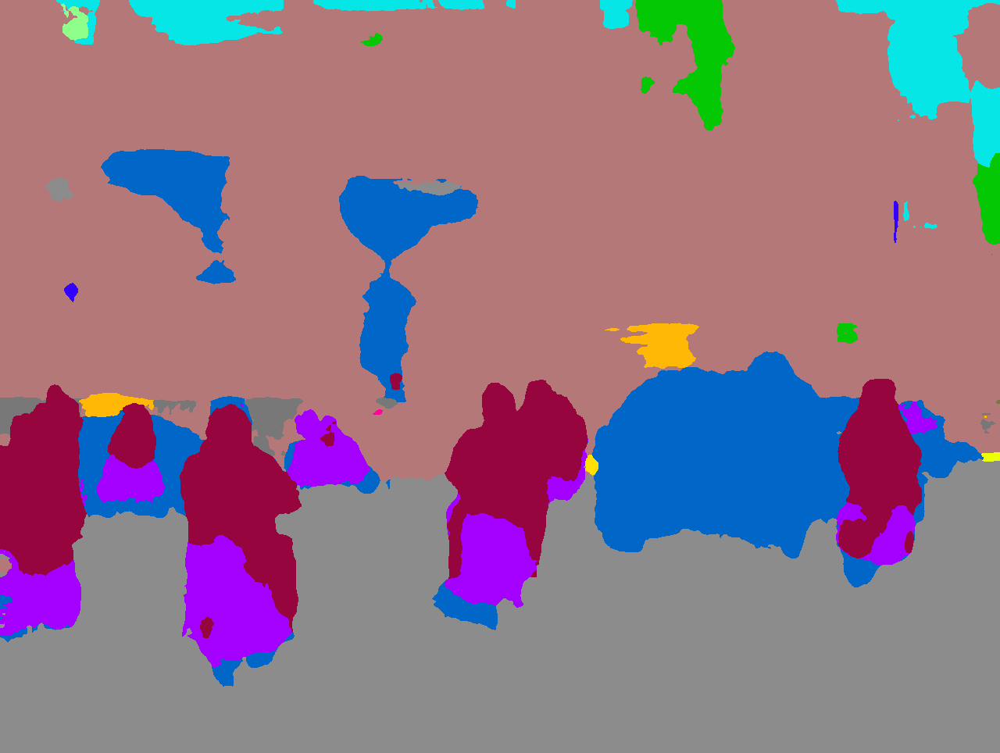

In [10]:
seg_map = palette[seg].squeeze().to(torch.uint8).permute(2, 0, 1)
show_image(seg_map)

In [11]:
seg_map.shape

torch.Size([3, 964, 1280])

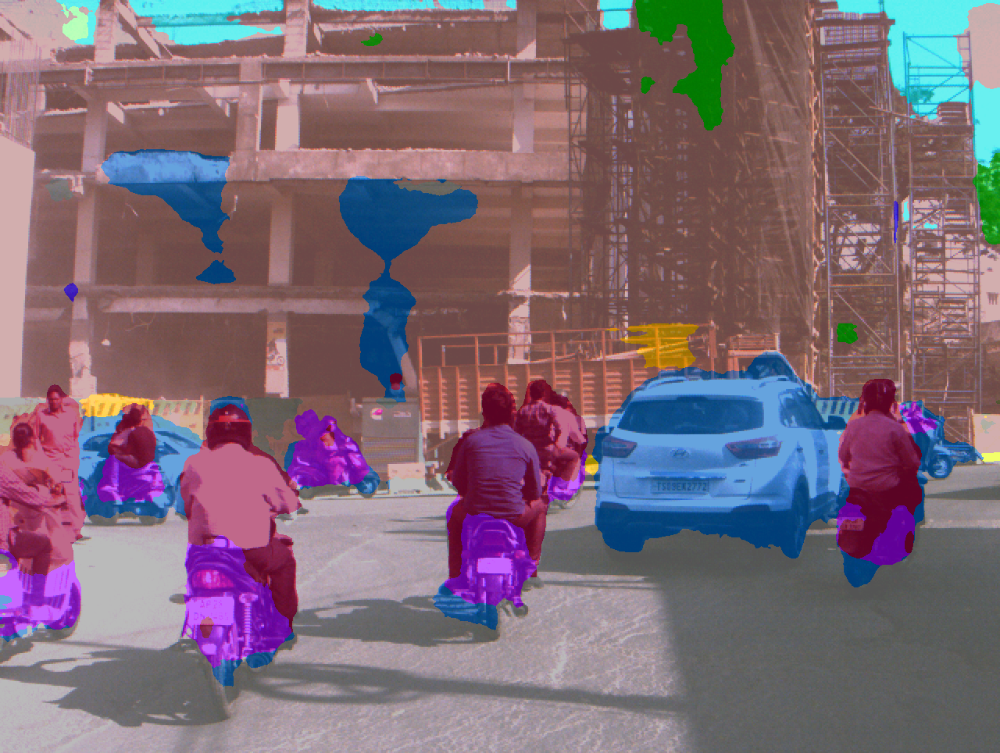

In [92]:
si_k = Image.blend(T.functional.to_pil_image(image),
                   T.functional.to_pil_image(seg_map), 
                   0.6)
                 
si_k

In [111]:
legend_img = create_legend_image(legend_data)

In [115]:
import numpy as np

660

In [ ]:
H = 964
W = 1280

new_img = Image.new("RGB",(2*W+300,H), color=(255, 255, 255))
new_img.paste(T.functional.to_pil_image(image),(0,0))
new_img.paste(si_k,(W+50,0))
new_img.paste(legend_img,(2*W+75,25))

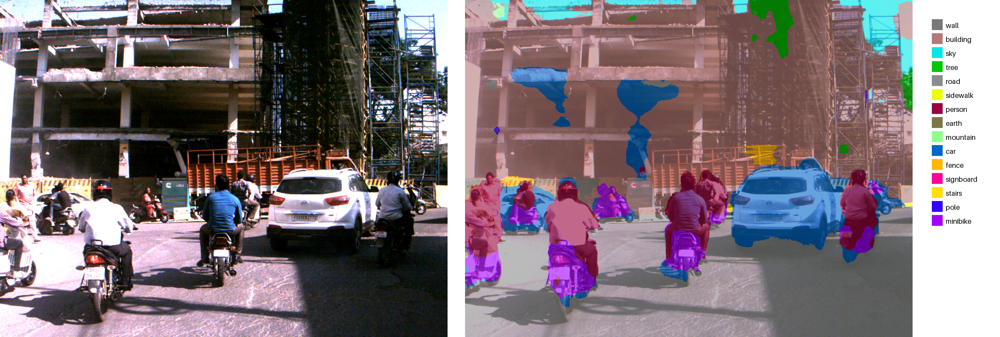

In [94]:
new_img

# automate

In [140]:
def ade_infer(img_path):
    image = io.read_image(img_path)[:3]
    _,H,W = image.shape
    prep_image = image.float() / 255
    # normalize
    prep_image = T.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))(prep_image)
    # add batch size
    prep_image = prep_image.unsqueeze(0)
    prep_image.shape

    with torch.inference_mode():
        seg = model(prep_image)
    seg = seg.softmax(1).argmax(1).to(int)
    seg_map = palette[seg].squeeze().to(torch.uint8).permute(2, 0, 1)
    si_k = Image.blend(T.functional.to_pil_image(image),
                   T.functional.to_pil_image(seg_map), 
                   0.6)
    legend_img = create_legend_image(legend_data)
    H = max(H,np.array(legend_img).shape[0])
    new_img = Image.new("RGB",(2*W+300,H), color=(255, 255, 255))
    new_img.paste(T.functional.to_pil_image(image),(0,0))
    new_img.paste(si_k,(W+50,0))
    new_img.paste(legend_img,(2*W+75,0))
    return new_img

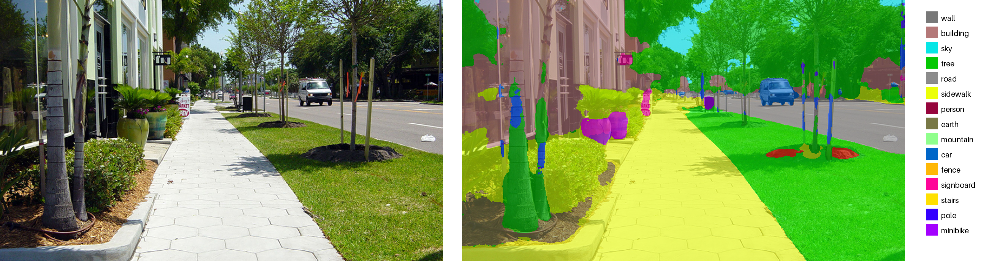

In [141]:
ade_infer('../../dataset/pedestrian1.png')

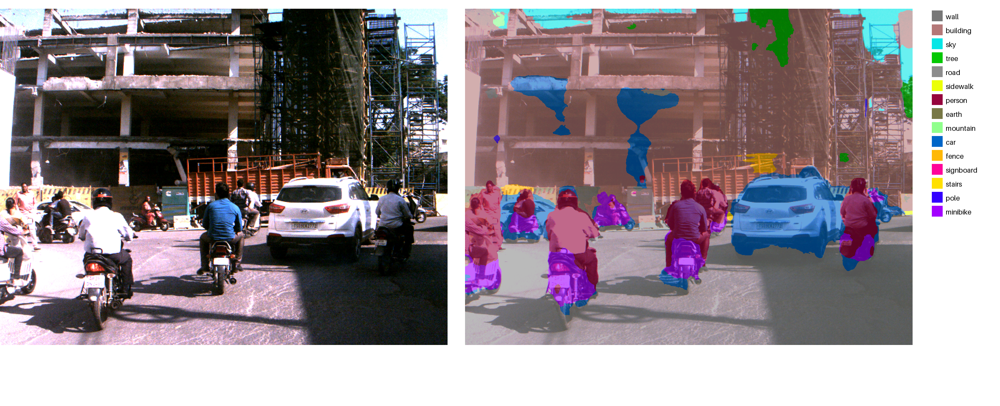

In [110]:
ade_infer('../../dataset/IDD_Segmentation/leftImg8bit/train/0/024541_leftImg8bit.png')

In [96]:
from pathlib import Path
GDRIVE=str(Path.home().expanduser()/'Google Drive/My Drive')

In [97]:
BASE_PATH = os.path.join(GDRIVE,'Walkability Index')

In [99]:
IMAGE_DATA_PATH = os.path.join(BASE_PATH,'Street Nodes','ExampleImages_10232024')

In [122]:
for city in ['tangerang','tangsel']:
    print(city)
    for image_name in tqdm(os.listdir(os.path.join(IMAGE_DATA_PATH,city))):
        OUT_PATH = os.path.join(BASE_PATH,city)
        os.makedirs(OUT_PATH,exist_ok=True)
        img_path = os.path.join(IMAGE_DATA_PATH,city,image_name)
        overlayed_img = ade_infer(img_path)
        overlayed_img.save(os.path.join(OUT_PATH,image_name.replace('.jpg','.png')))

tangerang


100%|██████████| 13/13 [00:55<00:00,  4.27s/it]


tangsel


100%|██████████| 14/14 [01:09<00:00,  4.93s/it]


In [105]:
img_path

'/Users/izzan/Google Drive/My Drive/Walkability Index/Street Nodes/ExampleImages_10232024/tangsel/note_tangsel_4314905799_2.jpg'

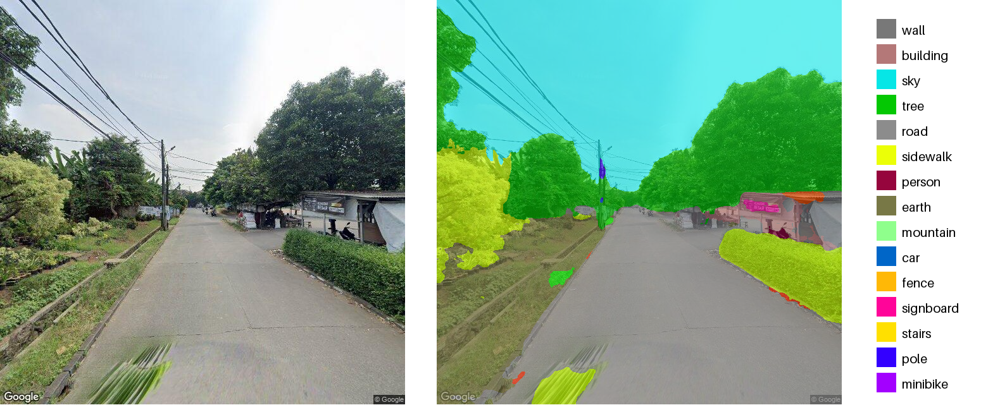

In [120]:
ade_infer(img_path)

In [98]:
os.listdir(BASE_PATH)

['Street Nodes', 'Walkability Index.gslides']